# IDEO Homework: Chicago Train Traffic & New Momofuku Ramen Store

In [4]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import seaborn as sns
sns.set(style = 'darkgrid')

In [5]:
'''Just exploring what's in the data set'''

"""Dataset can be found here: https://data.cityofchicago.org/Transportation/CTA-Ridership-L-Station-Entries-Daily-Totals/5neh-572f"""
ridership = pd.read_csv('CTA_-_Ridership_-__L__Station_Entries_-_Daily_Totals.csv')
print(ridership.describe())
print(ridership.corr())
print(ridership.head())

          station_id          rides
count  936632.000000  936632.000000
mean    40762.102672    3316.938266
std       446.383438    3202.839166
min     40010.000000       0.000000
25%     40370.000000    1124.000000
50%     40750.000000    2321.000000
75%     41150.000000    4353.000000
max     41700.000000   36323.000000
            station_id     rides
station_id    1.000000  0.040603
rides         0.040603  1.000000
   station_id       stationname        date daytype  rides
0       40350       UIC-Halsted  01/01/2001       U    273
1       41130    Halsted-Orange  01/01/2001       U    306
2       40760         Granville  01/01/2001       U   1059
3       40070  Jackson/Dearborn  01/01/2001       U    649
4       40090       Damen-Brown  01/01/2001       U    411


<br>

## Warmup Question 1: 
Which stop has the highest average ridership per day, and what is it?


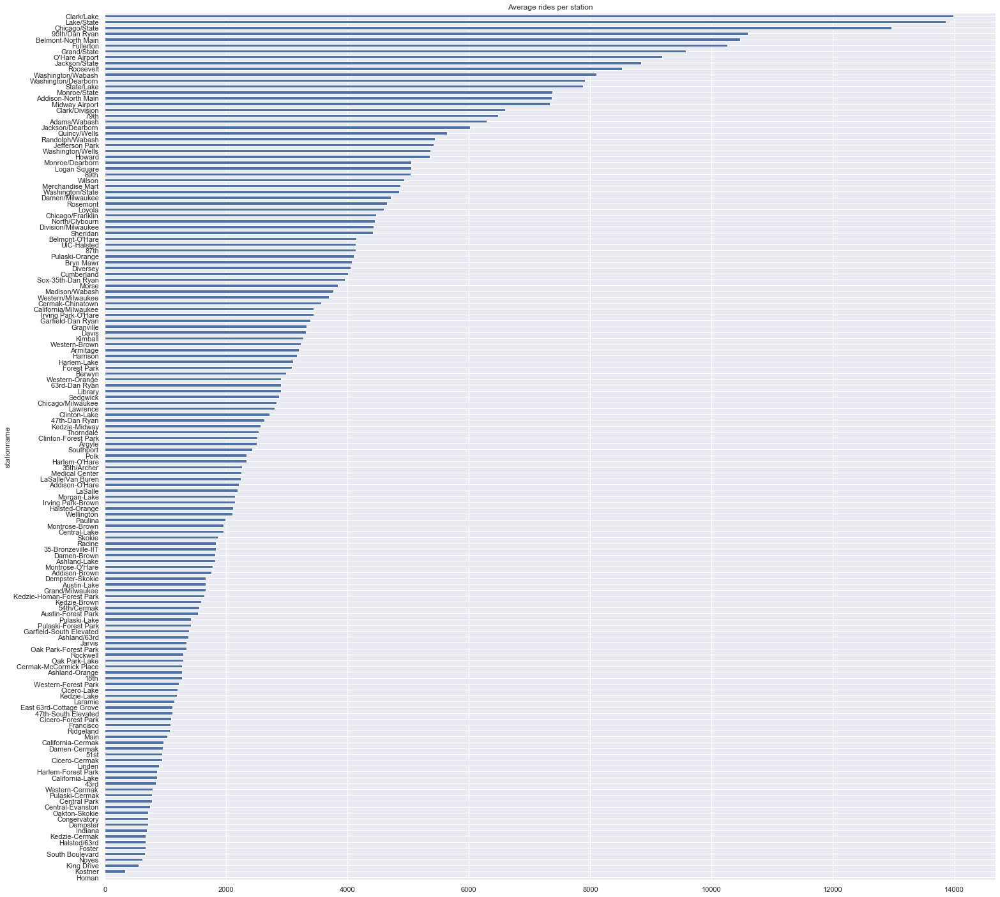

stationname
Clark/Lake       18067.456010
Lake/State       16372.226481
Chicago/State    14194.442291
95th/Dan Ryan    12429.147978
Fullerton        11793.557491
Name: rides, dtype: float64
stationname
Chicago/State         12072.885561
Belmont-North Main     9872.217112
Lake/State             9680.221154
Grand/State            9560.236111
Fullerton              7925.001068
Name: rides, dtype: float64
stationname
O'Hare Airport        8505.150907
Chicago/State         8350.930277
Belmont-North Main    7315.935053
Grand/State           7017.371538
Lake/State            6577.490458
Name: rides, dtype: float64


<Figure size 432x288 with 0 Axes>

In [3]:
'''Average rides barchart'''
ridership.groupby('stationname').rides.mean().sort_values(ascending = True).plot(kind = 'barh', figsize = (25,25))
plt.title('Average rides per station')
plt.show()
plt.clf()

'''What is the averagen number of rides for each daytype?'''
ridership_w = ridership[ridership.daytype == 'W']
print(ridership_w.groupby('stationname').rides.mean().sort_values(ascending = False).head())

ridership_a = ridership[ridership.daytype == 'A']
print(ridership_a.groupby('stationname').rides.mean().sort_values(ascending = False).head())

ridership_u = ridership[ridership.daytype == 'U']
print(ridership_u.groupby('stationname').rides.mean().sort_values(ascending = False).head())

## Ans:

The highest average ridership per day overall and during weekdays is Clark/Lake. 

However, during Saturdays, it is Chicago/State and on Sundays is O'Hare Airport(seems like it's popular to fly from/to O'Hare Airport on a Sunday.)

<br>

## Warmup Question 2: 
What’s the standard deviation for the Washington/Wabash stop? What’s your hypothesis for why?


      index  station_id        stationname        date daytype  rides
0    861962       41700  Washington/Wabash  08/01/2017       W      0
1    862060       41700  Washington/Wabash  08/02/2017       W      0
2    862201       41700  Washington/Wabash  08/03/2017       W      0
3    862355       41700  Washington/Wabash  08/04/2017       W      0
4    862517       41700  Washington/Wabash  08/05/2017       A      0
..      ...         ...                ...         ...     ...    ...
513  935912       41700  Washington/Wabash  12/27/2018       W   7187
514  936056       41700  Washington/Wabash  12/28/2018       W   8059
515  936200       41700  Washington/Wabash  12/29/2018       A   4479
516  936344       41700  Washington/Wabash  12/30/2018       U   4203
517  936488       41700  Washington/Wabash  12/31/2018       W   5335

[518 rows x 6 columns]
               index  station_id         rides
count     518.000000       518.0    518.000000
mean   899286.501931     41700.0   8100.13

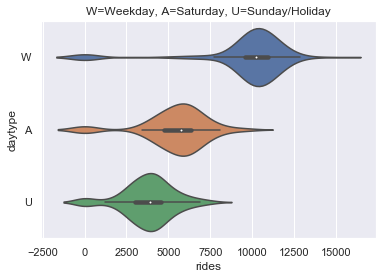

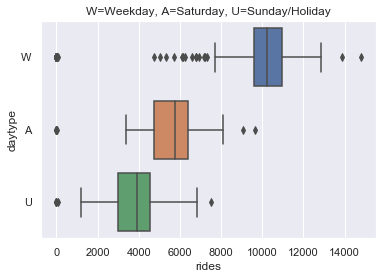

In [4]:
'''Selecting only washington/wabash'''
washington = ridership[ridership.stationname =='Washington/Wabash'].reset_index()
print(washington)
'''A brief overview of washington/wabash'''
print(washington.describe())

'''Taking a quick look at the std of the rest of the stations'''
ridership_std = ridership.groupby(['stationname', 'daytype']).rides.std().sort_values(ascending = False).reset_index()
print(ridership_std)
print(ridership_std[ridership_std.stationname == 'Washington/Wabash'])

sns.violinplot(data = washington, x = 'rides', y = 'daytype')
plt.title('W=Weekday, A=Saturday, U=Sunday/Holiday')
plt.show()
plt.clf

sns.boxplot(data=washington, x='rides', y='daytype')
plt.title('W=Weekday, A=Saturday, U=Sunday/Holiday')
plt.show()


## Ans:

The std of Washington/Wabash rides is 3422.595650 overall. 2731.567544 during weekdays, 1886.062283 during Saturdays and 1515.673957 on Sundays.

However, I do believe that washington/wabash should have a smaller standard deviation if we eliminate the outliers of 0 number of rides in August 2017, during which the station was still in the midst of being built.

Completely away from the topic of std, it interesting to note that washington/wabash is 11th highest for average number of rides with its highest traffic during the weekday. Which may point to washington/wabash as a train station located in an area where people have to stop at for work. 
If not, washington/wabash could be an area where people stay that has high traffic because the station has 5 lines which is used to commute to work. The surrounding areas look nice enough and even has a park according to Google maps, which gives the people less incentive to venture away from the area during the Weekends.

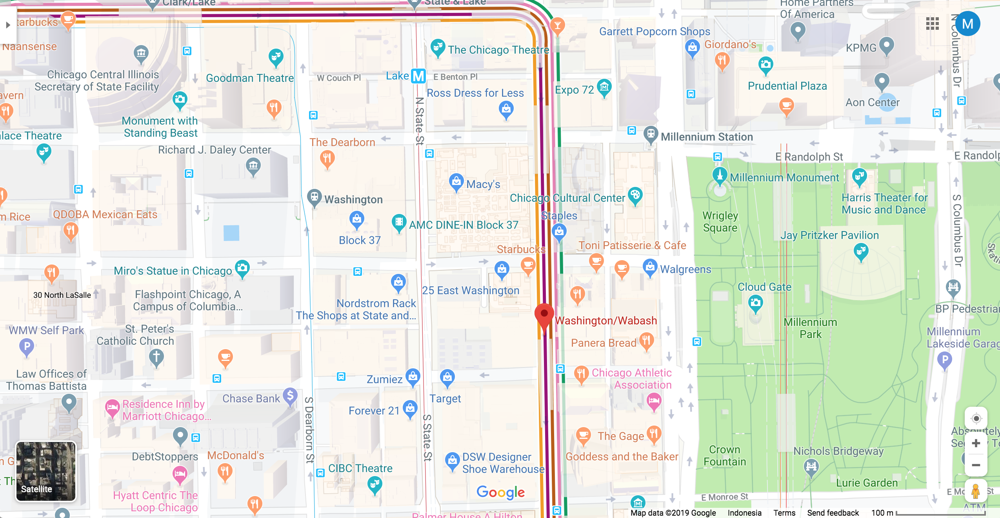

<br>

# Challenge Questions: 
Please choose a specific business and tell us which business you chose; any kind of business will do. Imagine you’re helping that business owner in Chicago and s/he is looking to open a new location. In the form of writing, potentially supplemented by sketches (computer-drawn or hand-drawn) and links, we want to see your response to these questions:
1. What questions could you potentially explore/answer with this data?
2. Ideally, what other data would you gather or combine to learn even more?
3. How would you want to see data presented, to make it actionable by you or others?
4. How could an algorithm or model be used? How might your client interact with that algorithm or model?

Furthermore, we want to see the results of 2–3 hours of work, using the real data, towards making those ideas a reality. The results could include findings from the data, code, Python/R notebooks, a visualization, results of a statistical model you built, etc. Try not to hide things or throw them away— we want to see your work!

### Momofuku's Noodle Bar(https://momofukunoodlebar.com/) is expanding to Chicago! Finally, the ramen store that started Dave Chang's food empire is no longer only in reach for NYC IDEO! 

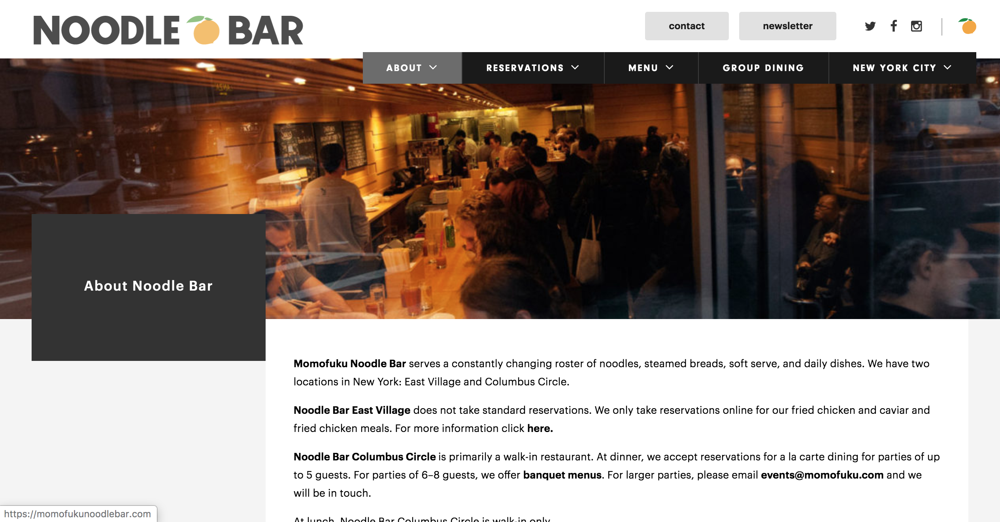
<br>

1. I think with the data, we can explore:
>1. Any up and coming locations from an increase of rides
>2. The top popular stations in average rides
>3. The number of ramen competitors around select train stations

2. The first two questions can be easily explored with our current data set. But the number of competitors around train stations is much more iffy. I believe I may have to go to a review website like yelp to gather the data. 

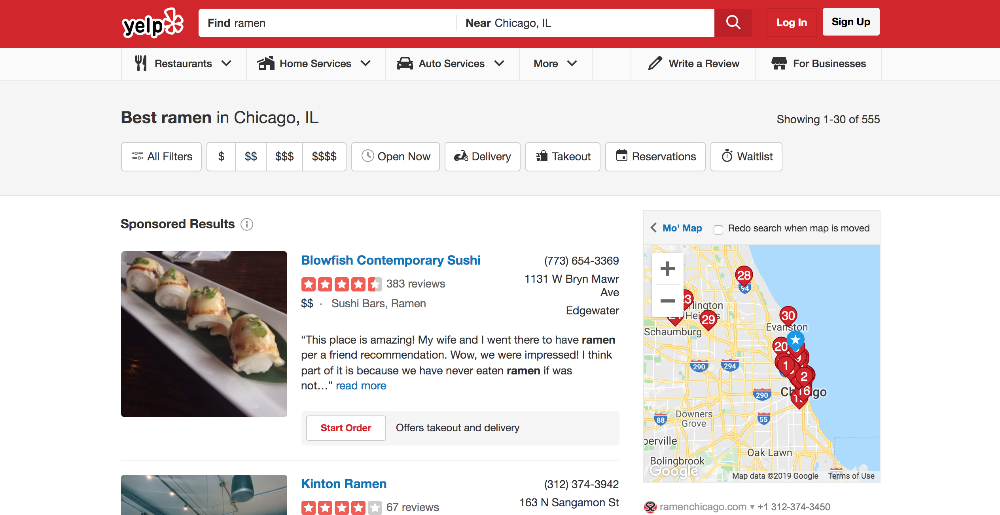
<br>

3. After looking at the additional data set about the trains stations, I realise that they added in the latitude and longitude for each station. Pugging it into Google mymaps, I managed to come up with something like this:

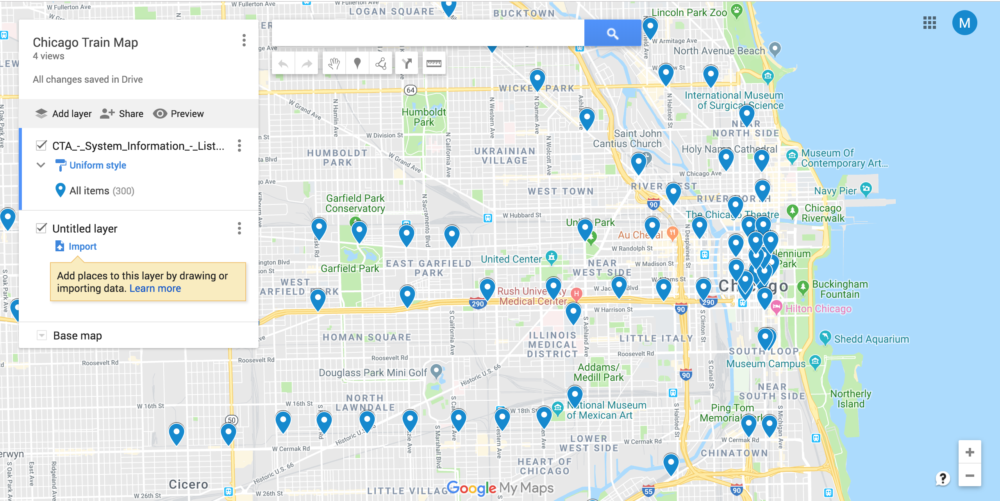

I think it would be an interesting visualisation if I managed to mark all of the up and coming train stations, popular train stations and competitors of ramen restaurants in one map. This model can be used to predict future popular areas and mark out any blue ocean areas for the client to open their new store!

4. If possible a model that shows the mean amount of rides per area would help the client pick out the best location for their new store. Something like the image below but it will have varying opacity/intensity of colors to show the difference in riders

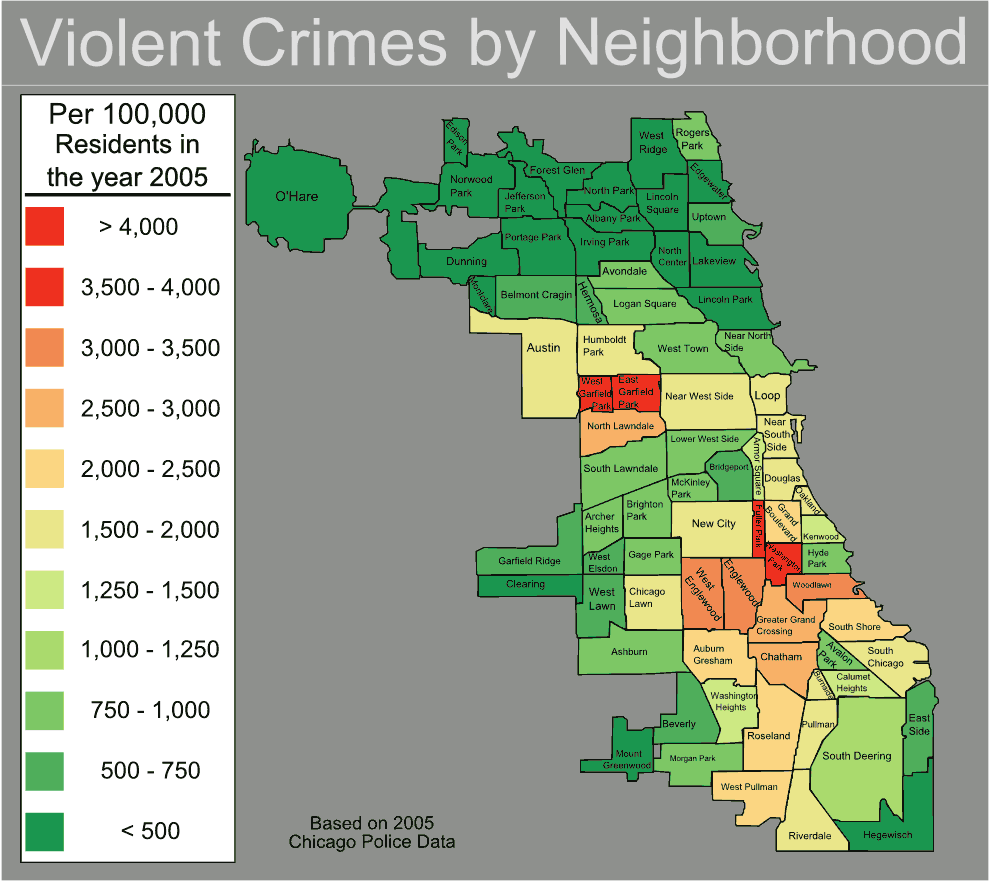

In [5]:
'''I'm importing a new data set which is a monthly version of the original data set given for this assessment 
because my computer can't handle the large amount of data to create facetgrid graphs.

Data set link: https://data.cityofchicago.org/Transportation/CTA-Ridership-L-Station-Entries-Monthly-Day-Type-A/t2rn-p8d7'''
ridership_m = pd.read_csv('CTA_-_Ridership_-__L__Station_Entries_-_Monthly_Day-Type_Averages___Totals.csv')

'''Changing the date to y/m/d because it's easier to sort values'''
ridership_m['month_beginning'] = pd.to_datetime(ridership_m.month_beginning).dt.strftime('%Y/%m/%d')
print(ridership_m.head())

ridership_mg = ridership_m.sort_values(['stationame', 'month_beginning'])
print(ridership_mg.head())
print(ridership_mg.dtypes)
split_df = ridership_mg['month_beginning'].str.split('(\d+)', expand=True)

ridership_mg['year'] = pd.to_numeric(split_df[1])
ridership_mg['month'] = pd.to_numeric(split_df[3])

   station_id stationame month_beginning  avg_weekday_rides  \
0       40900     Howard      2001/01/01             6233.9   
1       41190     Jarvis      2001/01/01             1489.1   
2       40100      Morse      2001/01/01             4412.5   
3       41300     Loyola      2001/01/01             4664.5   
4       40760  Granville      2001/01/01             3109.8   

   avg_saturday_rides  avg_sunday-holiday_rides  monthtotal  
0              3814.5                    2408.6      164447  
1              1054.0                     718.0       40567  
2              3064.5                    2087.8      119772  
3              3156.0                    1952.8      125008  
4              2126.0                    1453.8       84189  
     station_id stationame month_beginning  avg_weekday_rides  \
76        40830       18th      2001/01/01              967.3   
217       40830       18th      2001/02/01              997.6   
358       40830       18th      2001/03/01            

      stationame  year  month  monthtotal
0           18th  2001      1       21301
1           18th  2001      2       19955
2           18th  2001      3       21998
3           18th  2001      4       21297
4           18th  2001      5       22675
...          ...   ...    ...         ...
30750     Wilson  2018      8      176496
30751     Wilson  2018      9      188547
30752     Wilson  2018     10      203364
30753     Wilson  2018     11      177241
30754     Wilson  2018     12      149216

[30755 rows x 4 columns]


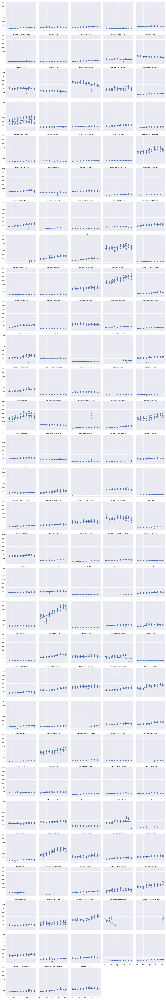

In [6]:
ridership_year = ridership_mg.groupby(['stationame', 'year', 'month']).monthtotal.sum().reset_index()
print(ridership_year)
ax = sns.lmplot(x = 'year', y = 'monthtotal', col = 'stationame',
          data = ridership_year, truncate = True,
          col_wrap = 5)
ax.set(xticks=np.arange(2001,2018,4))

### The stations which have the most significant rise over the past 17 years are:
>Addison-North Main
Belmont North Main
California/Milwaukee
Cermak-Chinatown
Chicago/Franklin
Chicago/Milwaukee
Chicago/State
Clark/Lake
Clinton/Lake
Damen/Milwaukee
Diversey
Division/Milwaukee
Fullerton
Grand/Milwaukee
Grand/State
Harrison
Lake/State
Library
Logan Square
Merchandise Mart
Monroe/Dearborn
Monroe/State
North/Clybourn
O’Hare Airport
Roosevelt
State/Lake
Washington/Dearborn
Washington/Milwaukee

While the stations with more than 150,000 riders as the average are:
>95th Dan/Ryan
Adams/Wabash
Addison-North Main
Belmont-North Main
California/Milwaukee
Chicago/Franklin
Chicago/State
Clark/Division
Clark/Lake
Damen/Milwaukee
Fullerton
Grand/State
Jackson/Dearborn
Jackson/State
Jefferson/Park
Lake/State
Logan Square
Loyola
Merchandise Mart
Midway Airport
Monroe/Dearborn
Monroe/State
O’Hare Airport
Quincy/Wells
Randolph/Wabash
Roosevelt
Rosemont
Sheridan
State/Lake
UC-Halsted
Washington/Dearborn
Washington/Wells
Washington/Milwaukee
Wilson
<br>

My first big problem! I don't know how to webscrape yet with Beautifulsoup. Luckily after googling I found out there are webscraping programs like parsehub which I will be using for this.
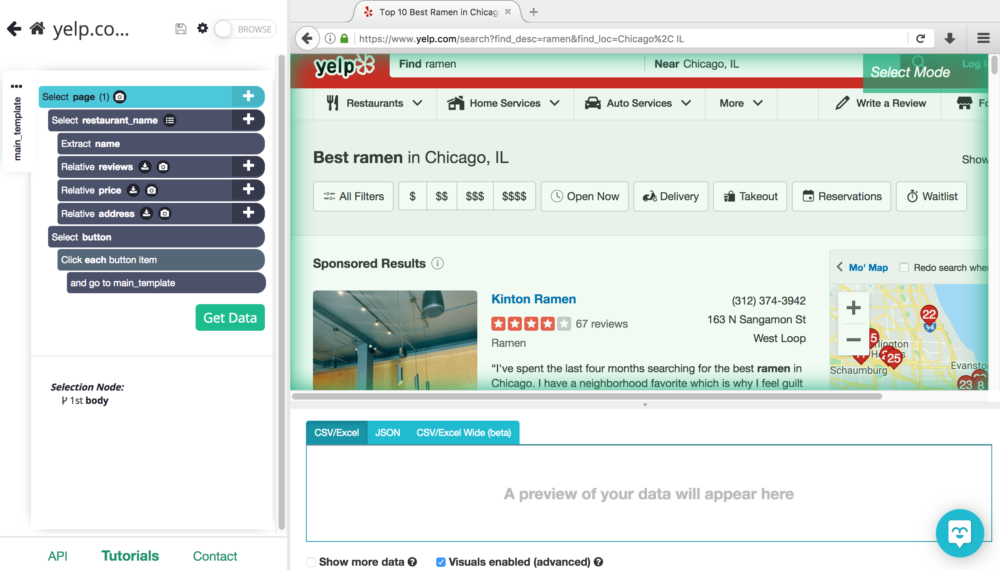

In [7]:
#ramen = pd.read_csv('ramen3.csv')
#ramen = ramen[ramen.restaurant_name_address.notnull()]
#print(ramen.restaurant_address_state)

'''My second big problem is now realising that I can't input all of the addresses one by one into a latitude/longitude
converter! Google comes to the rescue again! I managed to find a library called geopy!
Link: https://geopy.readthedocs.io/en/latest/#'''

#from geopy.geocoders import Nominatim

#latlong = []
#for i in ramen.restaurant_address_state:
    #geolocator = Nominatim(user_agent="my-application", timeout = 5)
    #location = geolocator.geocode(i)
    #print((location.latitude, location.longitude))
    #latlong.append([location.latitude, location.longitude])

"My second big problem is now realising that I can't input all of the addresses one by one into a latitude/longitude\nconverter! Google comes to the rescue again! I managed to find a library called geopy!\nLink: https://geopy.readthedocs.io/en/latest/#"

In [8]:
'''The code was giving me much problems, so unfortunately I had to do some things manually, such as changing the
addresses of the wrong addresses by crossreferencing google maps. 
The len(latlong) helped me find which index the code stopped at.'''
#print(len(latlong))

'''Adding the latitude and longitude before saving it into a csv'''
#ramen['latlong'] = latlong
#ramen.to_csv('ramen_geo.csv')

'Adding the latitude and longitude before saving it into a csv'

# A Choropleth on Chicago's Wards

In [6]:
"""I was surfing youtube and came across this video: https://youtu.be/Yd5oEIBFQ_E
In the video, Halfdan Rump talks about a python library called folium which fitted perfectly with what I wanted to do
The codes below are to combine the two given data sets on their MAP_ID/station_id so each station the data set will
be complete with each station's location as well as ward number"""

"""Dataset link: https://data.cityofchicago.org/Transportation/CTA-System-Information-List-of-L-Stops/8pix-ypme"""
station = pd.read_csv('CTA_-_System_Information_-_List_of__L__Stops.csv')
station2 = station[['STATION_NAME', 'MAP_ID', 'Location', 'Zip Codes', 'Wards']].reset_index()
station_ward = station2.groupby(['MAP_ID','STATION_NAME', 'Location', 'Zip Codes', 'Wards']).index.sum().reset_index()

ridership_mean = ridership.groupby(['station_id', 'stationname']).rides.mean().reset_index()

In [7]:
merge = pd.merge(ridership_mean, station_ward, left_on = 'station_id', right_on='MAP_ID', how = 'outer')

#merge2 = merge[merge.isnull().any(axis=1)]

"""Changing wards from float to string because folium takes a string input for the database to match with the geojson"""
merge = merge[merge['Wards'].notnull()]
merge.Wards = merge.Wards.astype(int)
merge.Wards = merge.Wards.astype(str)

#print(merge)

"""exporting high and rising stations into a new csv"""

"""high = merge[merge['stationname'].isin(["95th/Dan Ryan", "Adams/Wabash", "Addison-North Main",
                        "Belmont-North Main", "California/Milwaukee", "Chicago/Franklin",
                        "Chicago/State", "Clark/Division", "Clark/Lake", "Damen/Milwaukee",
                        "Fullerton Grand/State", "Jackson/Dearborn", "Jackson/State", "Jefferson/Park", 
                        "Lake/State", "Logan Square", "Loyola", "Merchandise Mart", "Midway Airport",
                        "Monroe/Dearborn", "Monroe/State", "O’Hare Airport", "Quincy/Wells", "Randolph/Wabash",
                        "Roosevelt", "Rosemont", "Sheridan", "State/Lake", "UC-Halsted", "Washington/Dearborn",
                        "Washington/Wells", "Washington/Milwaukee Wilson"])]
high.to_csv('station_high.csv')

rising = station[station['STATION_NAME'].isin(["Addison-North Main", "Belmont North Main",
                     "California/Milwaukee","Cermak-Chinatown", "Chicago/Franklin", "Chicago/Milwaukee",
                     "Chicago/State", "Clark/Lake", "Clinton/Lake", "Damen/Milwaukee", "Diversey",
                     "Division/Milwaukee", "Fullerton", "Grand/Milwaukee", "Grand/State", "Harrison",
                     "Lake/State", "Library", "Logan Square", "Merchandise Mart", "Monroe/Dearborn",
                     "Monroe/State", "North/Clybourn", "O’Hare Airport", "Roosevelt", "State/Lake",
                     "Washington/Dearborn", "Washington/Milwaukee"])]
rising.to_csv('station_rising.csv')"""

'high = merge[merge[\'stationname\'].isin(["95th/Dan Ryan", "Adams/Wabash", "Addison-North Main",\n                        "Belmont-North Main", "California/Milwaukee", "Chicago/Franklin",\n                        "Chicago/State", "Clark/Division", "Clark/Lake", "Damen/Milwaukee",\n                        "Fullerton Grand/State", "Jackson/Dearborn", "Jackson/State", "Jefferson/Park", \n                        "Lake/State", "Logan Square", "Loyola", "Merchandise Mart", "Midway Airport",\n                        "Monroe/Dearborn", "Monroe/State", "O’Hare Airport", "Quincy/Wells", "Randolph/Wabash",\n                        "Roosevelt", "Rosemont", "Sheridan", "State/Lake", "UC-Halsted", "Washington/Dearborn",\n                        "Washington/Wells", "Washington/Milwaukee Wilson"])]\nhigh.to_csv(\'station_high.csv\')\n\nrising = station[station[\'STATION_NAME\'].isin(["Addison-North Main", "Belmont North Main",\n                     "California/Milwaukee","Cermak-Chinatown", "Chicago/

In [13]:
high = pd.read_csv("station_high.csv")
high.Location = high.Location.astype(str)
split_df = high.Location.str.split('(,)', expand=True)
split_df[0] = split_df[0].str.replace('(', '')
split_df[2] = split_df[2].str.replace(')', '')
high['lat'] = pd.to_numeric(split_df[0])
high['long'] = pd.to_numeric(split_df[2])

rise = pd.read_csv("station_rising.csv")
rise.Location = rise.Location.astype(str)
split_df2 = rise.Location.str.split('(,)', expand=True)
split_df2[0] = split_df2[0].str.replace('(', '')
split_df2[2] = split_df2[2].str.replace(')', '')
rise['lat'] = pd.to_numeric(split_df2[0])
rise['long'] = pd.to_numeric(split_df2[2])

ramen = pd.read_csv("ramen_geo.csv")
ramen.latlong = ramen.latlong.astype(str)
split_df3 = ramen.latlong.str.split('(,)', expand=True)
split_df3[0] = split_df3[0].str.replace('[', '')
split_df3[2] = split_df3[2].str.replace(']', '')
ramen['lat'] = pd.to_numeric(split_df3[0])
ramen['long'] = pd.to_numeric(split_df3[2])

In [21]:
import folium
from folium.plugins import MarkerCluster

"""Geojson data link here: https://www.chicago.gov/city/en/depts/doit/dataset/boundaries_-_wards.html"""
m = folium.Map(location=[41.881832, -87.623177],zoom_start = 10, tiles = 'cartodbpositron')
folium.Choropleth(
    geo_data="Boundaries Wards.geojson",
    name='choropleth',
    data=merge,
    columns=['Wards', 'rides'],
    key_on='feature.properties.ward',
    fill_color='BuPu',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Average number of rides per Ward in Chicago'
).add_to(m)


marker_cluster = MarkerCluster(name='Stations with high average rides').add_to(m)
marker_cluster2 = MarkerCluster(name='Stations that are rising').add_to(m)
marker_cluster3 = MarkerCluster(name='Other ramen stores in Chicago').add_to(m)

folium.LayerControl().add_to(m)

for i in range(0,len(high)):
    folium.Marker([high['lat'][i], high['long'][i]], popup=high['STATION_NAME'][i], icon=folium.Icon(color='blue')).add_to(marker_cluster)
    
for i in range(0,len(rise)):
    folium.Marker([rise['lat'][i], rise['long'][i]], popup=rise['STATION_NAME'][i], icon=folium.Icon(color='green')).add_to(marker_cluster2)

for i in range(0,len(ramen)):
    folium.Marker([ramen['lat'][i], ramen['long'][i]], popup=ramen['restaurant_name_name'][i], icon=folium.Icon(color='lightgray')).add_to(marker_cluster3)

"""Exporting the file because it's too big to be rendered here"""
m.save('Choropleth of Chicago no of rides per ward.html')

In [20]:
"""It is rather unfortunate that within the data set, there are multiple stations which did not have any wards assigned
which is why there are multiple areas that are darkened, and practically all of our popular stations are situated within
those areas.

There are 2 wards which have high average number of rides per ward and 3 that comes in second. Cermak-Chinatown
station just so happens to be in one of these 2nd lesser purple wards."""

from IPython.display import IFrame

IFrame(src='Choropleth of Chicago no of rides per ward.html', width=1000, height=650)

# The Final Product
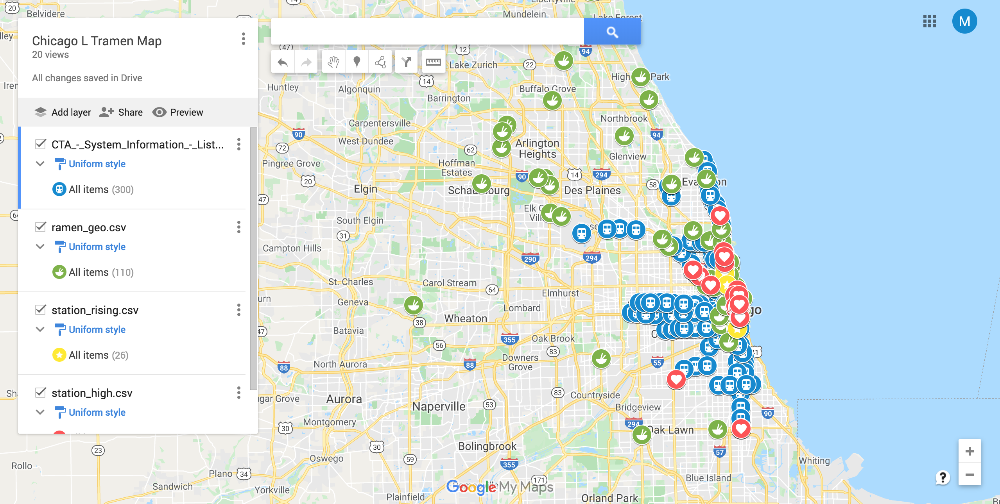
Putting it all together, we now have a map of Chicago's list train stations(blue trains), ramen stores from Yelp(green noodle bowls), high average train stations(red hearts) and up and coming train stations(yellow stars).
The choropleth may be a little cluttered  so here's a google maps link:
https://drive.google.com/open?id=1mVyUlsKUbV9kNtMLWH67CX9xnBvf_Qli&usp=sharing

We can't really see what's going on when it's so zoomed out, so let's take a closer look.

## Areas with high ridership train stations

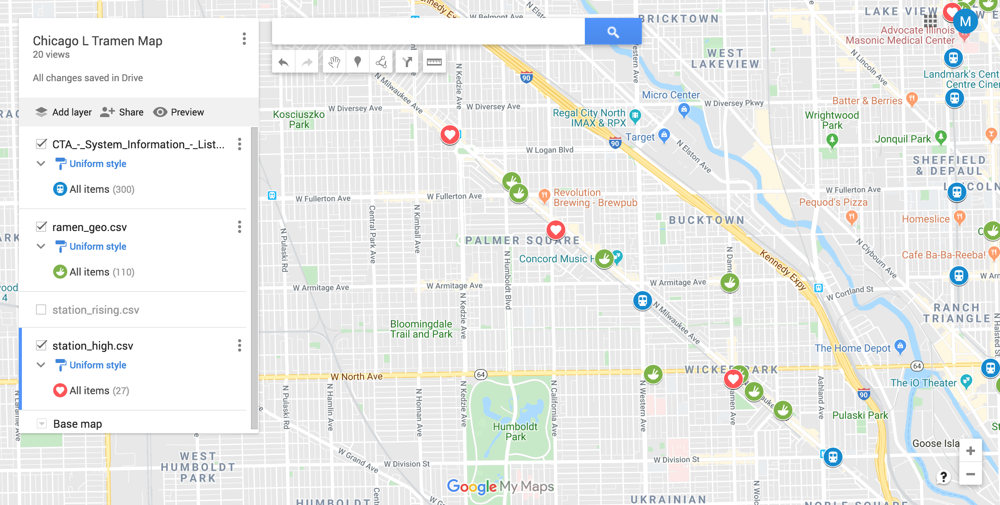
The N Milwaukee Ave seems to be a rather popular stretch. Stations from Grand Milwaukee to Logan Square have a high average. Which probably explains the large number of other ramen stores along the stretch.

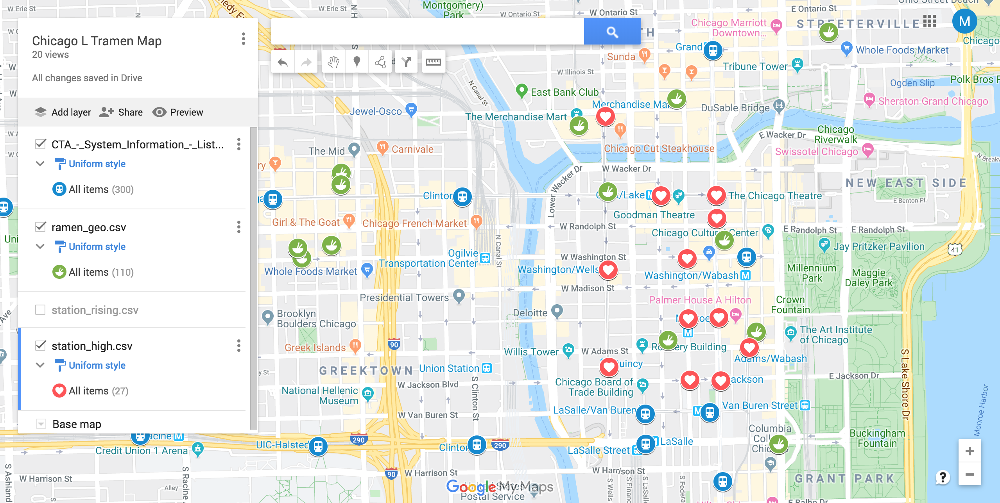
The main chicago area is filled with train stations with high ridership but most likely the rent in this area will be high to match the upscale area. At the same time, there are multiple ramen stores that already exist in this area as competitors.

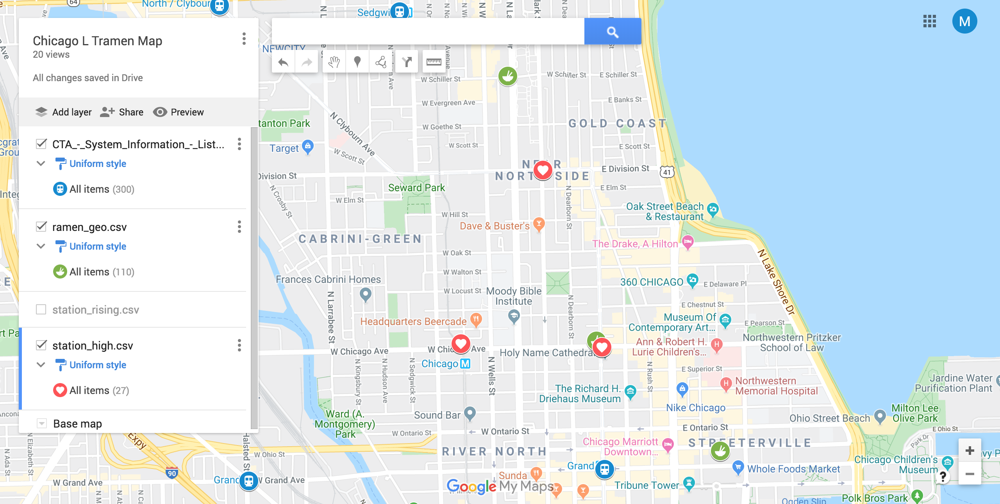

Other areas which have high ridership train stations and no ramen stores are upper Chicago and Roosevelt station
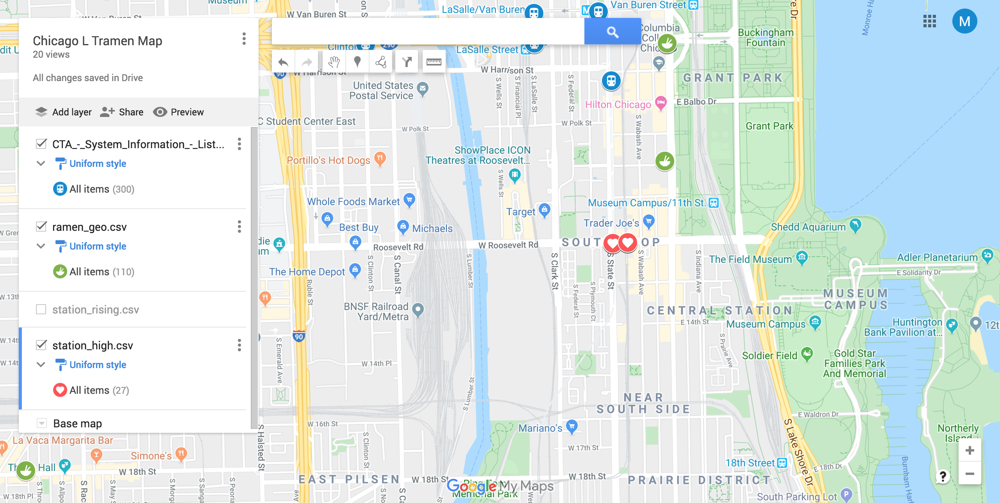

## Areas with rising ridership train stations

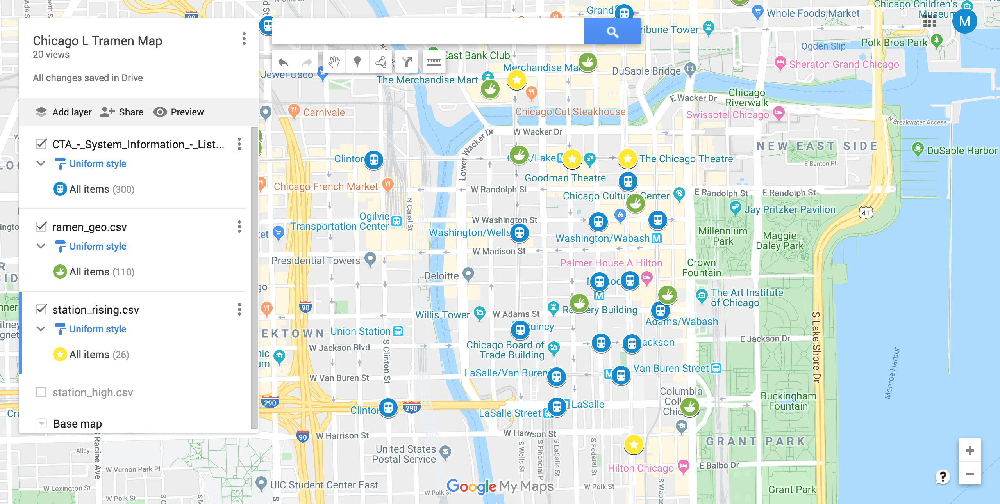
The area with the highest number of high traffic stations, as well as seeing a rise in ridership is within the upper Chicago area


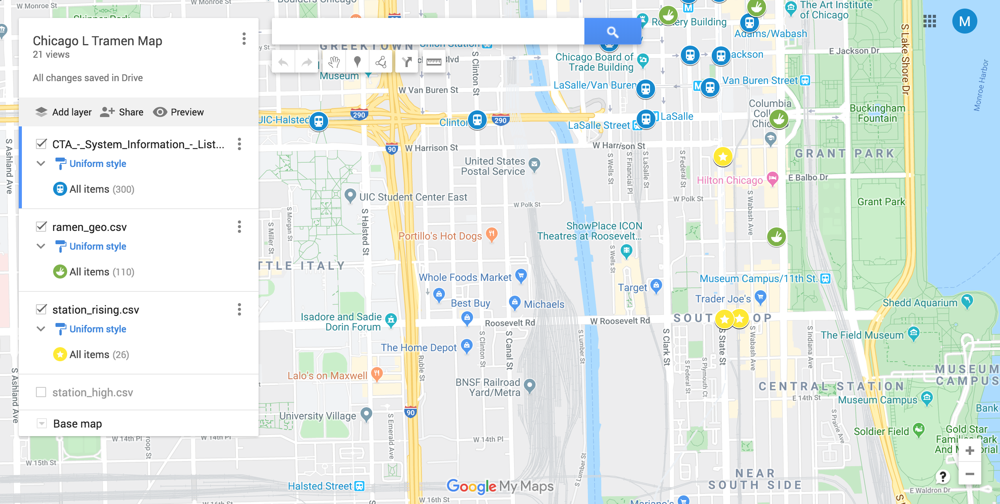
The area of lower Chicago's Roosevelt station has only 1 ramen store and is in between two high rising stations.

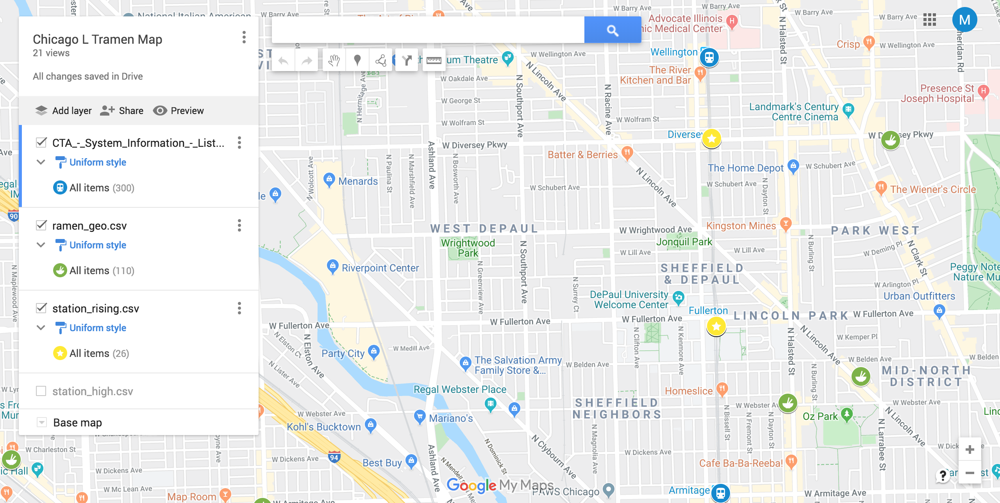
Further away from Chicago's main area above, is a stretch of from Fullerton to Diversey mimics the N Milwaukee Ave with no ramen stores in sight.

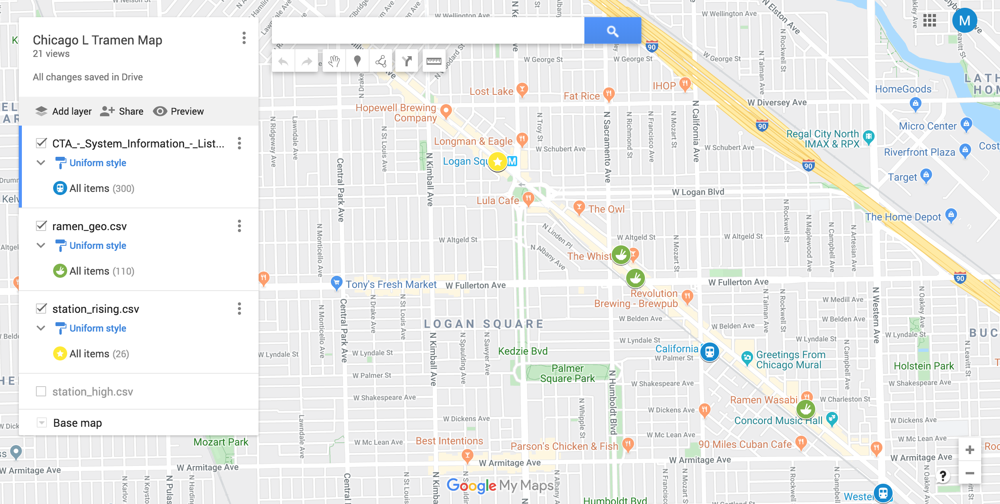
The only station in N Milwaukee Ave with a high rise however, is Logan Square station

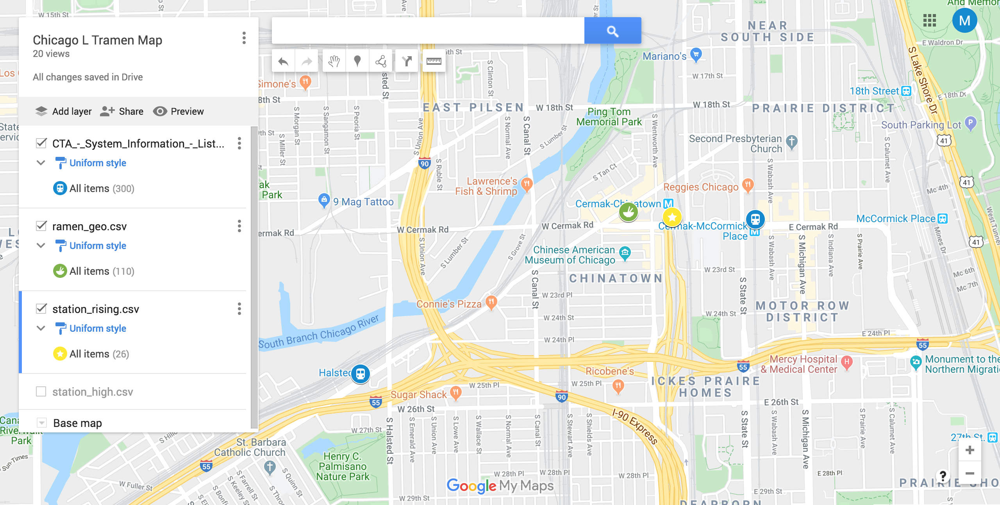
Finally, Cermak-Chinatown is also a high rising train station. With it being a station that is high rising, high average ridership and in a ward that has the 2nd highest average rides, this area may be a good consideration to open a new store.